# Julia Academy

## Data Science Course

# 8. Graph Analysis in Julia

**Huda Nassar**

**Source:** https://github.com/JuliaAcademy/DataScience/blob/main/08.%20Graphs.ipynb

We will explore how to analysis graphed data in Julia

In [4]:
using LightGraphs
using MatrixNetworks
using VegaDatasets
using DataFrames
using SparseArrays
using LinearAlgebra
using Plots
using VegaLite

In [5]:
ENV["LINES"], ENV["COLUMNS"] = 15, 200;

In [6]:
airports = DataFrame(dataset("airports"))

,iata,name,city,state,country,latitude,longitude
,String,String,String,String,String,Float64,Float64
1,00M,Thigpen,Bay Springs,MS,USA,31.9538,-89.2345
2,00R,Livingston Municipal,Livingston,TX,USA,30.6859,-95.0179
3,00V,Meadow Lake,Colorado Springs,CO,USA,38.9457,-104.57
4,01G,Perry-Warsaw,Perry,NY,USA,42.7413,-78.0521
5,01J,Hilliard Airpark,Hilliard,FL,USA,30.688,-81.9059
6,01M,Tishomingo County,Belmont,MS,USA,34.4917,-88.2011
7,02A,Gragg-Wade,Clanton,AL,USA,32.8505,-86.6115
8,02C,Capitol,Brookfield,WI,USA,43.0875,-88.1779
9,02G,Columbiana County,East Liverpool,OH,USA,40.6733,-80.6414


In [7]:
airport_flight_map = DataFrame(dataset("flights-airport"))

,origin,destination,count
,String,String,Int64
1,ABE,ATL,853
2,ABE,BHM,1
3,ABE,CLE,805
4,ABE,CLT,465
5,ABE,CVG,247
6,ABE,DTW,997
7,ABE,JFK,3
8,ABE,LGA,9
9,ABE,ORD,1425


Let's get the unique airports

In [8]:
airports_with_flights = vcat(airport_flight_map[!, :origin], airport_flight_map[!, :destination])
airport_vertex_list = unique(airports_with_flights)
length(airport_vertex_list)

305

Now let's subset the airports dataframe to just the ones that have an IATA (unique 3 letter airport identifier) number included in the routes dataset

In [9]:
airports_subset = filter(row -> row[:iata] in airport_vertex_list, airports)

,iata,name,city,state,country,latitude,longitude
,String,String,String,String,String,Float64,Float64
1,ABE,Lehigh Valley International,Allentown,PA,USA,40.6524,-75.4404
2,ABI,Abilene Regional,Abilene,TX,USA,32.4113,-99.6819
3,ABQ,Albuquerque International,Albuquerque,NM,USA,35.0402,-106.609
4,ABY,Southwest Georgia Regional,Albany,GA,USA,31.5355,-84.1945
5,ACK,Nantucket Memorial,Nantucket,MA,USA,41.2531,-70.0602
6,ACT,Waco Regional,Waco,TX,USA,31.6113,-97.2305
7,ACV,Arcata,Arcata/Eureka,CA,USA,40.9781,-124.109
8,ACY,Atlantic City International,Atlantic City,NJ,USA,39.4576,-74.5772
9,ADK,Adak,Adak,AK,USA,51.878,-176.646


Now to do graphical analysis we need to create an adjacency matrix between origin and destination flights

In [10]:
# for each row in the flight map, get the airport index for the origin vertices and destination vertices
vertex_origin_idx = findfirst.(isequal.(airport_flight_map[!,:origin]), [airport_vertex_list])
vertex_dest_idx = findfirst.(isequal.(airport_flight_map[!,:destination]), [airport_vertex_list])
# we'll wait the edges by the flight counts between vertices
edgeweights = airport_flight_map[!,:count]
;

In [11]:
A = sparse(vertex_origin_idx, vertex_dest_idx, 1, length(airport_vertex_list), length(airport_vertex_list))
A = max.(A,A')

305×305 SparseMatrixCSC{Int64,Int64} with 5668 stored entries:
  [19 ,   1]  =  1
  [30 ,   1]  =  1
  [62 ,   1]  =  1
  [64 ,   1]  =  1
  [74 ,   1]  =  1
  ⋮
  [268, 303]  =  1
  [81 , 304]  =  1
  [268, 304]  =  1
  [101, 305]  =  1
  [268, 305]  =  1

Graphs tend to be represented by sparse matrices, which is why we are using this datastructure type. We can use the `spy` function to see this sparsity along the indices:

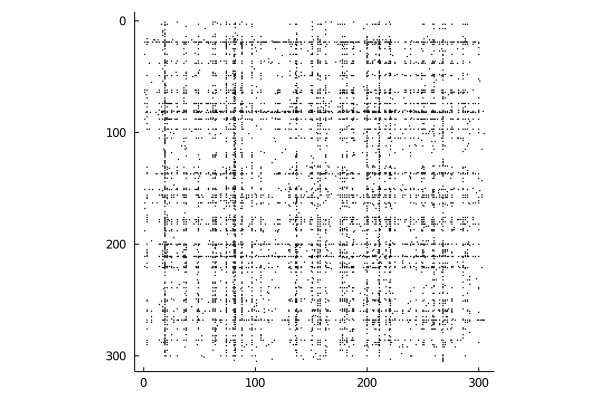

In [12]:
spy(A)

In [13]:
issymmetric(A)

true

#### Strong Components

We want to know how many connected groups there are in the graph


In [14]:
components = MatrixNetworks.scomponents(A)

MatrixNetworks.Strong_components_output([1, 1, 1, 1, 1, 1, 1, 1, 1, 1  …  1, 1, 1, 1, 1, 1, 1, 1, 1, 1], [305], 1, MatrixNetwork{Int64}(305, [1, 13, 15, 56, 57, 60, 61, 67, 70, 71  …  5619, 5626, 5628, 5629, 5656, 5658, 5659, 5665, 5667, 5669], [19, 30, 62, 64, 74, 88, 151, 163, 168, 188  …  115, 143, 156, 158, 221, 268, 81, 268, 101, 268], [1, 1, 1, 1, 1, 1, 1, 1, 1, 1  …  1, 1, 1, 1, 1, 1, 1, 1, 1, 1]))

In [15]:
components.sizes

1-element Array{Int64,1}:
 305

There is one connected component in the graph, which means that starting at any airport, it is possible to get to every other airport in the graph. There are no isolated components.

### Degree

The degree is the number of edges adjacent to each vertex. The degree distribution will tell us how many airports are typically connected to other airports across the spectrum

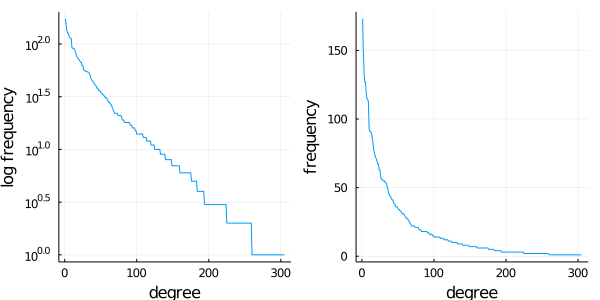

In [16]:
vertex_degrees = sum(A, dims=2)[:]   # using a matrix representation it is enough to sum along one dimension of the symmetric matrix

p1 = plot(sort(vertex_degrees, rev=true), ylabel="log frequency", yaxis=:log)
p2 = plot(sort(vertex_degrees, rev=true), ylabel="frequency")
plot(p1, p2, xlabel="degree", legend=false, size=(600, 300))

So it seems liek the airline transportation network seems to follow a powerlaw degree distribution. Knowing if the degree distribution fits a well known model can be helpful for further studying (eg consulting relevant literature or using relevant techniques)

### Airport with most number of nodes

In [17]:
max_degree_idx = argmax(vertex_degrees)
most_connected_airport = airport_vertex_list[max_degree_idx]

"ATL"

Let's plot all the connecting flights to this airport using VegaLite

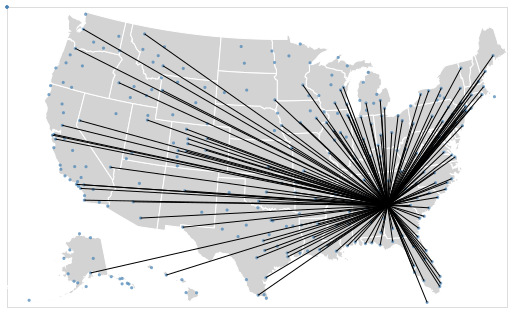

In [18]:
us10m = dataset("us-10m")
@vlplot(width=500, height=300) +
@vlplot(
    mark={
        :geoshape,
        fill=:lightgray,
        stroke=:white
    },
    data={
        values=us10m,
        format={
            type=:topojson,
            feature=:states
        }
    },
    projection={type=:albersUsa},
) +
@vlplot(
    :circle,
    data=airports_subset,
    projection={type=:albersUsa},
    longitude="longitude:q",
    latitude="latitude:q",
    size={value=10},
    color={value=:steelblue}
)+
@vlplot(
    :rule,
    data=airport_flight_map,
    transform=[
        {filter={field=:origin, equal=:ATL}},
        {
            lookup=:origin,
            from={
                data=airports_subset,
                key=:iata,
                fields=["latitude", "longitude"]
            },
            as=["origin_latitude", "origin_longitude"]
        },
        {
            lookup=:destination,
            from={
                data=airports_subset,
                key=:iata,
                fields=["latitude", "longitude"]
            },
            as=["dest_latitude", "dest_longitude"]
        }
    ],
    projection={type=:albersUsa},
    longitude="origin_longitude:q",
    latitude="origin_latitude:q",
    longitude2="dest_longitude:q",
    latitude2="dest_latitude:q"
)

## Shortest Path Problem

We will use Dijkstra's algorithm for finding the shortest path between any two nodes

In [19]:
ATL_paths = dijkstra(A, max_degree_idx)

([1.0, 2.0, 1.0, 1.0, 2.0, 2.0, 2.0, 1.0, 2.0, 2.0  …  1.0, 1.0, 3.0, 2.0, 1.0, 3.0, 2.0, 2.0, 2.0, 2.0], [19, 82, 19, 19, 151, 82, 270, 19, 17, 17  …  19, 19, 154, 268, 19, 54, 268, 221, 268, 268])

The output above is a tuple and for each vertex in the graph, the first element shows the distance (i.t.o of number of hops) between every airport and Atlanta

In [20]:
length(ATL_paths[1])

305

In [21]:
ATL_paths[1][max_degree_idx]   # distance to self is zero

0.0

So now, given the shortest path mapping, let's find the node which is farthest yet from ATL (using the shortest possible path)

In [22]:
maximum(ATL_paths[1])

3.0

So here are actually 4 airports which require two connections to reach Atlanta. Let's use just the first:

In [24]:
@show stop1 = argmax(ATL_paths[1])
airport_vertex_list[stop1]

stop1 = argmax(ATL_paths[1]) = 123


"GST"

In [25]:
# the second element of the Dijkstra tuple shows the predecessor for every node on the way to reaching Atlanta
@show stop2 = ATL_paths[2][stop1]
airport_vertex_list[stop2]

stop2 = (ATL_paths[2])[stop1] = 152


"JNU"

In [26]:
@show stop3 = ATL_paths[2][stop2]
airport_vertex_list[stop3]

stop3 = (ATL_paths[2])[stop2] = 259


"SEA"

In [27]:
@show stop4 = ATL_paths[2][stop3]
airport_vertex_list[stop4]

stop4 = (ATL_paths[2])[stop3] = 19


"ATL"

Now let's plot this path

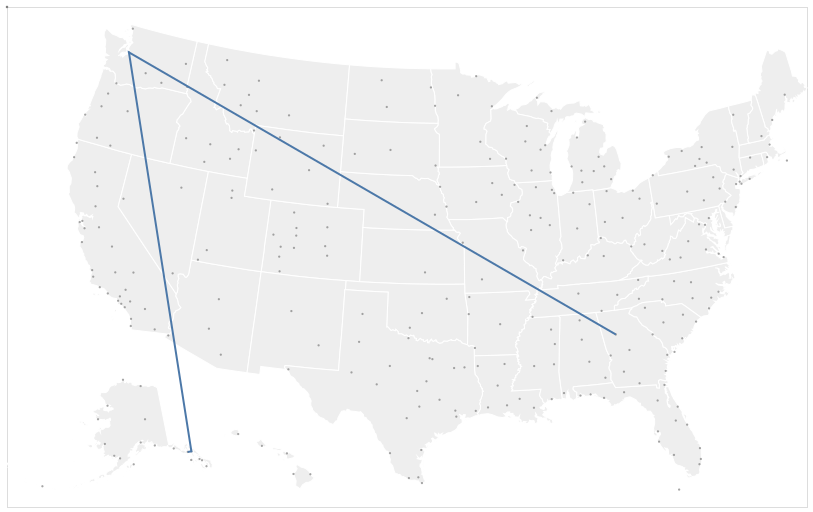

In [28]:
us10m = dataset("us-10m")
airports = dataset("airports")

@vlplot(width=800, height=500) +
@vlplot(
    mark={
        :geoshape,
        fill="#eee",
        stroke=:white
    },
    data={
        values=us10m,
        format={
            type=:topojson,
            feature=:states
        }
    },
    projection={type=:albersUsa},
) +
@vlplot(
    :circle,
    data=airports_subset,
    projection={type=:albersUsa},
    longitude="longitude:q",
    latitude="latitude:q",
    size={value=5},
    color={value=:gray}
) +
@vlplot(
    :line,
    data={
        values=[
            {airport=:ATL,order=1},
            {airport=:SEA,order=2},
            {airport=:JNU,order=3},
            {airport=:GST,order=4}
        ]
    },
    transform=[{
        lookup=:airport,
        from={
            data=airports,
            key=:iata,
            fields=["latitude","longitude"]
        }
    }],
    projection={type=:albersUsa},
    longitude="longitude:q",
    latitude="latitude:q",
    order={field=:order,type=:ordinal}
)

### Minimum Spanning Tree

The idea of a minimum spanning tree is to connect all nodes in the graph with as few edges as possible

In [29]:
ti, tj, tv, nverts = MatrixNetworks.mst_prim(A)   # t stands for tree

([2, 3, 4, 5, 6, 7, 8, 9, 10, 11  …  296, 297, 298, 299, 300, 301, 302, 303, 304, 305], [66, 286, 19, 151, 82, 197, 19, 17, 17, 19  …  19, 182, 231, 268, 141, 54, 268, 156, 268, 101], [1, 1, 1, 1, 1, 1, 1, 1, 1, 1  …  1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 305)

In [30]:
mst_edges = DataFrame(:ei=>airport_vertex_list[ti], :ej=>airport_vertex_list[tj])

,ei,ej
,String,String
1,ABI,CMI
2,ABQ,TPA
3,ABY,ATL
4,ACK,JFK
5,ACT,DFW
6,ACV,MRY
7,ACY,ATL
8,ADK,ANC
9,ADQ,ANC


Now let's plot the MST

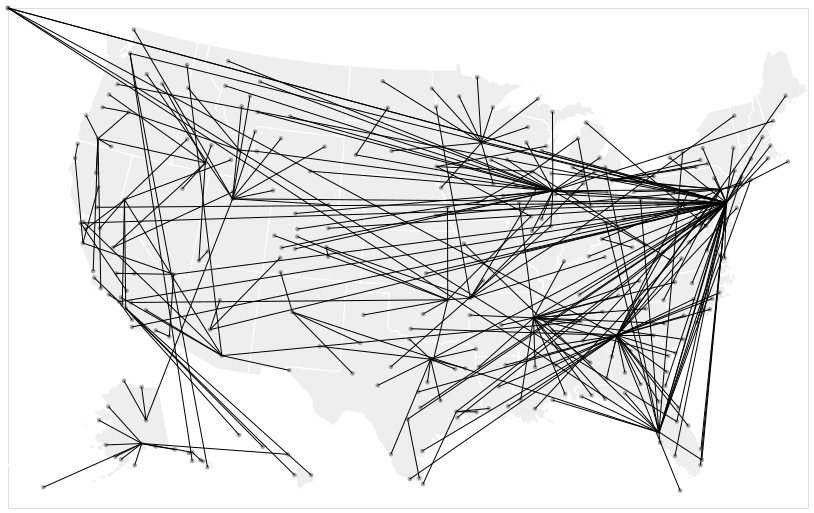

In [31]:
@vlplot(width=800, height=500) +
@vlplot(
    mark={
        :geoshape,
        fill="#eee",
        stroke=:white
    },
    data={
        values=us10m,
        format={
            type=:topojson,
            feature=:states
        }
    },
    projection={type=:albersUsa},
) +
@vlplot(
    :circle,
    data=airports_subset,
    projection={type=:albersUsa},
    longitude="longitude:q",
    latitude="latitude:q",
    size={value=20},
    color={value=:gray}
) +
@vlplot(
    :rule,
    data=mst_edges,
    transform=[
        {
            lookup=:ei,
            from={
                data=airports_subset,
                key=:iata,
                fields=["latitude", "longitude"]
            },
            as=["originx", "originy"]
        },
        {
            lookup=:ej,
            from={
                data=airports_subset,
                key=:iata,
                fields=["latitude", "longitude"]
            },
            as=["destx", "desty"]
        }
    ],
    projection={type=:albersUsa},
    longitude="originy:q",
    latitude="originx:q",
    longitude2="desty:q",
    latitude2="destx:q"
)

## PageRank

PageRank is an algorithm developed by Google founders Sergey Brin and Larry Page to rank nodes in a graph



In [32]:
?MatrixNetworks.pagerank

## `pagerank`

PageRank is the stationary distribution of a Markov chain defined as follows. The behavior of the chain at state i is: 

  * with probability $lpha$, randomly transition to an out-neighbor of the current node (based on a weighted probabilities if the graph has non-negative weights).
  * with probability $1-lpha$, jump to a random node chosen anywhere in the network.
  * if there are no out-neighbors, then jump anywhere in the network  with equal probability.

The solution satisfies a linear system of equations. This function will solve that linear system to a 1-norm error of `tol` where `tol` is chosen by default to be the machine precision. 

The solution is always a probability distribution.        

## Functions

  * `x = pagerank(A::SparseMatrixCSC{V,Int},alpha::Float64)`
  * `x = pagerank(A::MatrixNetwork{V},alpha::Float64)`
  * `x = pagerank(A,alpha,eps::Float64)` specifies solution tolerance too.

## Inputs

  * `A`: The sparse matrix or matrix network that you wish to use to compute PageRank. In the case of a sparse matrix, it must have non-negative values and the values will impact the  computation as we will compute a stochastic normalization  as part of the algorithm.
  * `alpha`: the teleportation parameter given above.
  * `tol`: the tolerance, the default choice is machine precision  for floating point, which is more than enough for almost all  applications.

## Examples

```
pagerank(A,alpha) 
            # return the standard PageRank vector 
            # with uniform teleportation and alpha=0.85 
            # computed to machine precision            
```


In [33]:
airport_pageranks = MatrixNetworks.pagerank(A, 0.85)   # 0.85 -> teleportation parameter of the Markov chain

305-element Array{Float64,1}:
 0.0020923348051623326
 0.0009436892155004145
 0.006119901015186467
 0.0006607117011710984
 0.0008603728281911192
 ⋮
 0.0016096866743709605
 0.0006494983427307581
 0.0015555904158222685
 0.0007866027711239782
 0.0008103673010237374

> Note that this vector is a probability distribution over the vertices

In [34]:
sum(airport_pageranks)

0.9999999999999999

Which is the most important airport in the network?

In [35]:
airport_vertex_list[argmax(airport_pageranks)]

"ATL"

It is Atlanta. Let's now add the pagerank values to the airports dataframe

In [36]:
insertcols!(airports_subset, :pagerank=>airport_pageranks)

,iata,name,city,state,country,latitude,longitude,pagerank
,String,String,String,String,String,Float64,Float64,Float64
1,ABE,Lehigh Valley International,Allentown,PA,USA,40.6524,-75.4404,0.00209233
2,ABI,Abilene Regional,Abilene,TX,USA,32.4113,-99.6819,0.000943689
3,ABQ,Albuquerque International,Albuquerque,NM,USA,35.0402,-106.609,0.0061199
4,ABY,Southwest Georgia Regional,Albany,GA,USA,31.5355,-84.1945,0.000660712
5,ACK,Nantucket Memorial,Nantucket,MA,USA,41.2531,-70.0602,0.000860373
6,ACT,Waco Regional,Waco,TX,USA,31.6113,-97.2305,0.000644587
7,ACV,Arcata,Arcata/Eureka,CA,USA,40.9781,-124.109,0.00159248
8,ACY,Atlantic City International,Atlantic City,NJ,USA,39.4576,-74.5772,0.00091292
9,ADK,Adak,Adak,AK,USA,51.878,-176.646,0.000767313


And let's plot the airports with a bubble showing the pagerank value

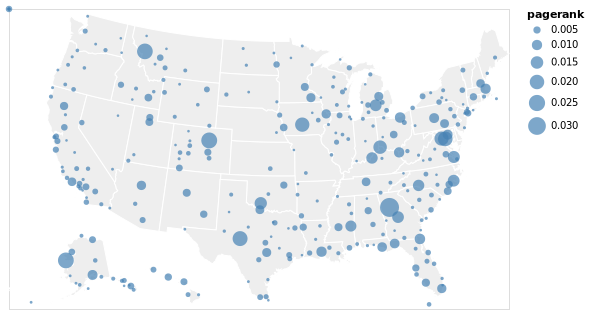

In [37]:
@vlplot(width=500, height=300) +
@vlplot(
    mark={
        :geoshape,
        fill="#eee",
        stroke=:white
    },
    data={
        values=us10m,
        format={
            type=:topojson,
            feature=:states
        }
    },
    projection={type=:albersUsa},
) +
@vlplot(
    :circle,
    data=airports_subset,
    projection={type=:albersUsa},
    longitude="longitude:q",
    latitude="latitude:q",
    size="pagerank:q",
    color={value=:steelblue}
)

## Clustering Coefficients

The clustering coefficient of a vertex tells us how close it and its neighbors are to forming a clique (complete graph). If the clustering coefficient is close to 1, then that vertex and its neighbors form a tight cluster.

In [38]:
clustering_coefs = MatrixNetworks.clustercoeffs(A)

305-element Array{Float64,1}:
 0.8333333333333334
 1.0
 0.6475609756097561
 6.94539012608485e-310
 0.6666666666666666
 ⋮
 0.0
 6.94544046797183e-310
 0.6666666666666666
 1.0
 1.0

In [39]:
insertcols!(airports_subset, :clustering_coefficients=>clustering_coefs)

,iata,name,city,state,country,latitude,longitude,pagerank,clustering_coefficients
,String,String,String,String,String,Float64,Float64,Float64,Float64
1,ABE,Lehigh Valley International,Allentown,PA,USA,40.6524,-75.4404,0.00209233,0.833333
2,ABI,Abilene Regional,Abilene,TX,USA,32.4113,-99.6819,0.000943689,1.0
3,ABQ,Albuquerque International,Albuquerque,NM,USA,35.0402,-106.609,0.0061199,0.647561
4,ABY,Southwest Georgia Regional,Albany,GA,USA,31.5355,-84.1945,0.000660712,6.94539e-310
5,ACK,Nantucket Memorial,Nantucket,MA,USA,41.2531,-70.0602,0.000860373,0.666667
6,ACT,Waco Regional,Waco,TX,USA,31.6113,-97.2305,0.000644587,6.94539e-310
7,ACV,Arcata,Arcata/Eureka,CA,USA,40.9781,-124.109,0.00159248,0.533333
8,ACY,Atlantic City International,Atlantic City,NJ,USA,39.4576,-74.5772,0.00091292,1.0
9,ADK,Adak,Adak,AK,USA,51.878,-176.646,0.000767313,6.94539e-310


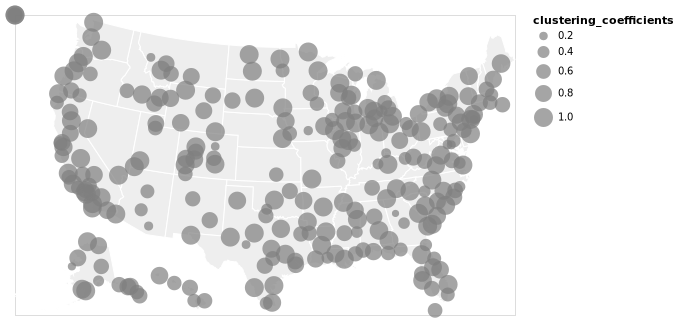

In [40]:
@vlplot(width=500, height=300) +
@vlplot(
    mark={
        :geoshape,
        fill="#eee",
        stroke=:white
    },
    data={
        values=us10m,
        format={
            type=:topojson,
            feature=:states
        }
    },
    projection={type=:albersUsa},
) +
@vlplot(
    :circle,
    data=airports_subset,
    projection={type=:albersUsa},
    longitude="longitude:q",
    latitude="latitude:q",
    size="clustering_coefficients:q",
    color={value=:gray}
)

### How would the flights network look using Fruchterman-Reingold graph representation?

In [44]:
using GraphRecipes

┌ Info: Precompiling GraphRecipes [bd48cda9-67a9-57be-86fa-5b3c104eda73]
└ @ Base loading.jl:1278


In [47]:
plot(graphplot(A), size=(800,600))

Using `GraphPlot.jl`

In [48]:
using GraphPlot

┌ Info: Precompiling GraphPlot [a2cc645c-3eea-5389-862e-a155d0052231]
└ @ Base loading.jl:1278


In [52]:
G = Graph(A)

{305, 2834} undirected simple Int64 graph

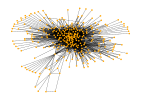

In [75]:
g = gplot(G, nodefillc=colorant"orange", edgestrokec=colorant"black")

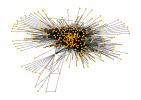

In [88]:
background = compose(context(), rectangle(), fill("white"))
compose(g,  background)